# From Multidimensional Poverty Index by block to average by urban neighborhood using free data from foursquare.
## A case Study in Medellín city, Colombia
### Rodriguez, Joan
### January, 2021

### 1. INTRODUCTION
#### Multidimensional Poverty Index (MPI) looks beyond income to understand how people experience poverty in multiple and simultaneous ways. It identifies how people are being left behind across three key dimensions: health, education and standard of living, comprising 10 indicators. People who experience deprivation in at least one third of these weighted indicators fall into the category of multidimensional poor.
### 1.1 PROBLEM
#### The Medellin city, uses this index by every block in the urban city, according to the last census data, but it is without information about every neighborhood. In addition, it does not have data about any relationship with principal venues around every neighborhood.
#### Taking in count the previous information, now the major question is: could the closer venues from each neighborhood has a relationship with poverty and with this data is possible to do prediction like an approximation to Multidimensional Poverty Index?
#### Using Machine learning and foursquare free data, we will try to resolve this!!!
### 1.2 INTEREST
#### General population and government are interested in deep knowledge about Multidimensional Poverty Index and how new changes and effort could reduce it. Any new prediction or relationship could be a useful tool in this effort.


In [4]:

import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library
import branca
import html

import seaborn as sns

import matplotlib.pyplot as plt
%matplotlib inline 
print('Main Libraries imported.')
 

Main Libraries imported.


### 2. DATA
### 2.1 DATA SOURCE
#### Free data from the last census in the year 2018, Multidimensional Poverty Index (MPI) is available at (https://geoportal.dane.gov.co/visipm/) like a shape file with it is index for each block in the city.(Figure 1)
#### Data about every neighborhood is available at (https://geomedellin-m-medellin.opendata.arcgis.com/datasets/barrio-vereda) like a shape file.
#### With QGIS software (https://www.qgis.org/es/site/) we change the data from shapefile to geojson to see neighborhoods and extract table data to excel, to use Multidimensional Poverty Index.
#### Data about venues is available at www.foursquare.com using a free account.

### 2.2 DATA CLEANING
#### Data with Neighborhood geometries was downloaded and opened with QGIS software to transform data from shapefile to geojson.
#### Excel spreadsheet with coordinates by Neighborhood.¶

In [6]:
#read geospatial coordinates by Neighborhood excel
Neighborhood_Medellin =pd.read_excel('/home/daren/data science/medellin/Neighborhoods_urban_Medelin.xlsx',encoding='latin-1')
Neighborhood_Medellin

,CODE,Neighborhoods,SUBTIPO_BA,Boroughs,SHAPEAREA,SHAPELEN,Lat,Long
0,1422,La Aguacatala,1,El Poblado,6.220902e+05,3302.658,6.199,-75.577
1,810,El Pinal,1,Villa Hermosa,4.134168e+05,3271.575,6.244,-75.545
2,719,Fuente Clara,1,Robledo,2.364412e+05,3022.338,6.278,-75.605
3,102,Santo Domingo Savio No.2,1,Popular,2.647505e+05,2943.708,6.298,-75.539
4,302,Las Granjas,1,Manrique,6.413493e+05,3964.702,6.279,-75.549
5,902,Barrios de Jesús,1,Buenos Aires,4.422357e+05,3754.624,6.230,-75.536
6,Inst_16,La Alpujarra,1,La Candelaria,3.164588e+05,2524.193,6.243,-75.577
7,1008,Corazón de Jesús,1,La Candelaria,3.302397e+05,2394.205,6.250,-75.577
8,907,Buenos Aires,1,Buenos Aires,2.931644e+05,2357.963,6.240,-75.555
9,501,Toscana,1,Castilla,2.900540e+05,2574.004,6.308,-75.559


#### 298 Urban Neighboorhood Geometries with coordinates

In [7]:
Neighborhood_Medellin.shape

(298, 8)

#### Dropping not essential columns

In [8]:
N_MED=Neighborhood_Medellin.drop(['SUBTIPO_BA','SHAPEAREA','SHAPELEN'], axis=1)
N_MED.head()

,CODE,Neighborhoods,Boroughs,Lat,Long
0,1422,La Aguacatala,El Poblado,6.199,-75.577
1,810,El Pinal,Villa Hermosa,6.244,-75.545
2,719,Fuente Clara,Robledo,6.278,-75.605
3,102,Santo Domingo Savio No.2,Popular,6.298,-75.539
4,302,Las Granjas,Manrique,6.279,-75.549


####  Excel spreadsheet with  Multidimensional Poverty Index(IPM) by block.

In [9]:
#read geospatial ipm by block
Neighborhood_ipm =pd.read_excel('/home/daren/data science/medellin/IPM_Neighborhood.xlsx',encoding='latin-1')
Neighborhood_ipm.head(30)

,CODE,Neighborhoods,SUBTIPO_BA,Boroughs,IPM
0,1509,Cristo Rey,1,Guayabal,9.6
1,1422,La Aguacatala,1,El Poblado,1.0
2,1414,El Castillo,1,El Poblado,0.0
3,1509,Cristo Rey,1,Guayabal,10.5
4,1421,Patio Bonito,1,El Poblado,0.0
5,1421,Patio Bonito,1,El Poblado,0.0
6,1421,Patio Bonito,1,El Poblado,6.8
7,1421,Patio Bonito,1,El Poblado,0.0
8,1421,Patio Bonito,1,El Poblado,0.0
9,1510,Guayabal,1,Guayabal,9.1


#### 13998 blocks with Multidimensional Poverty Index(IPM) values

In [10]:
Neighborhood_ipm.shape

(13998, 5)

#### Dropping not essential columns and using group by IPM average for each neighborhood, by column "CODE" such as reference to avoid duplicates names for different boroughs

In [11]:
N_M_IPM= Neighborhood_ipm.groupby(['CODE']).mean()
IPM = N_M_IPM.drop(['SUBTIPO_BA'], axis=1)
IPM.head()

,IPM
CODE,
101,23.347692
102,23.133333
103,29.224786
104,22.317722
105,22.534454


#### With Multidimensional Poverty Index (IPM) by block, now group by average IPM to each neighborhood and reduce it from 13998 blocks to 294 neighborhoods.

#### Merge essential columns data

In [17]:
N_MED_IPM=pd.merge(IPM, N_MED, on='CODE')
N_MED_IPM.head()

,CODE,IPM,Neighborhoods,Boroughs,Lat,Long
0,101,23.347692,Santo Domingo Savio No.1,Popular,6.298,-75.544
1,102,23.133333,Santo Domingo Savio No.2,Popular,6.298,-75.539
2,103,29.224786,Popular,Popular,6.299,-75.548
3,104,22.317722,Granizal,Popular,6.292,-75.546
4,105,22.534454,Moscú No.2,Popular,6.290,-75.550


In [18]:
N_MED_IPM.shape


(294, 6)

#### Search Medellin city coordinates using geolocator

In [20]:
address = 'Medellin, M'

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
latitudet = location.latitude
longitudet = location.longitude
print('The geograpical coordinate of Medellin City are {}, {}.'.format(latitudet, longitudet))

The geograpical coordinate of Medellin City are 6.2450865, -75.5447911.


#### GEOJSON Medellin Neighborhood limits

In [21]:
Neighborhood_limits = r'/home/daren/data science/medellin/Med_Neighborhood.geojson'

####  Medellin Urban Neighborhoods points (Red points) with coordinates in a Folium Map.
#### Each point will be use to download venues data from Foursquare

In [23]:
from folium import plugins
# create map of Medellin using latitude and longitude values
map_medellin = folium.Map(location=[latitudet, longitudet], zoom_start=11.2,control_scale = True)

folium.GeoJson(data=Neighborhood_limits,style_function=lambda x: {'fillColor':'none', 
                                          'weight': 0.7, 
                                          'color':'black'}).add_to(map_medellin)
# add markers to map
for Latitude, Longitude, Neighborhood in zip(N_MED_IPM['Lat'], N_MED_IPM['Long'], N_MED_IPM['Neighborhoods']):
    label = Neighborhood
    lab=str(label.encode('raw_unicode_escape'))[2:-1]
    lab= html.escape(lab)
    folium.CircleMarker(
        [Latitude, Longitude],
        popup="Neighborhood: "+lab,
        radius= 3,
        color='red',
        fill=True,
        fill_color='white',
        fill_opacity=0.8).add_to(map_medellin) 
plugins.Fullscreen(position='topright').add_to(map_medellin)
draw = plugins.Draw(export=True)
minimap = plugins.MiniMap( toggle_display=True, position='topleft',zoom_level_offset=-8)
map_medellin.add_child(minimap)    
map_medellin

#### Foursquare free account credential to download venues data
#### Version: 2021-01-06


In [27]:
CLIENT_ID = 'FNMLWWUHPBSRIX0LGI5OC3SNYXXXTHBX3MTLLU2DVLYAJGKE' # your Foursquare ID
CLIENT_SECRET = 'WSQ02DB2UPHLFPHVQ5ITHRZZG1TCMQA1QM43HUR11XGFGT5T' # your Foursquare Secret
VERSION = '20210106' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: FNMLWWUHPBSRIX0LGI5OC3SNYXXXTHBX3MTLLU2DVLYAJGKE
CLIENT_SECRET:WSQ02DB2UPHLFPHVQ5ITHRZZG1TCMQA1QM43HUR11XGFGT5T


#### A function to download a little bit more data from foursquare with a radius of 600 meters around each point inside each neighborhood

In [29]:
def getNearbyVenuest(codes, latitudes, longitudes, radius=600,ven_num=100):
 
    venues_list=[]
    for code, lat, lng in zip(codes, latitudes, longitudes):
        i=0
        while (i < ven_num+50):

            url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&offset={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius,
            i,
            LIMIT)
            
        # make the GET request
            results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
            venues_list.append([(
            code, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])
            i=i+50
            

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['CODE', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    print('Ok')
    return(nearby_venues)

In [30]:
Medellin_venues = getNearbyVenuest(codes=N_MED_IPM['CODE'],
                                  latitudes=N_MED_IPM['Lat'],
                                  longitudes=N_MED_IPM['Long']
                                 )

Ok


#### Using a free foursquare account and coordinates from each neighborhood with radius of 600 meters, it could extract 4058 venues and 236 unique categories from Medellin city, Colombia

In [31]:
print(Medellin_venues.shape)
Medellin_venues.head(30)

(4058, 7)


,CODE,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,101,6.298,-75.544,La Mesa del Barrio,6.294749,-75.544043,South American Restaurant
1,101,6.298,-75.544,Mi Cebi & Chela,6.293481,-75.541798,Caribbean Restaurant
2,101,6.298,-75.544,Metrocable Linea K - Estación Popular,6.295100,-75.548188,Cable Car
3,102,6.298,-75.539,Donde sabemos,6.293933,-75.538076,Liquor Store
4,102,6.298,-75.539,Mi Cebi & Chela,6.293481,-75.541798,Caribbean Restaurant
5,102,6.298,-75.539,Litografia RM,6.293831,-75.542321,Print Shop
6,103,6.299,-75.548,Tienda Don William,6.297740,-75.545235,Grocery Store
7,103,6.299,-75.548,Metrocable Linea K - Estación Popular,6.295100,-75.548188,Cable Car
8,103,6.299,-75.548,Metrocable Linea K - Estación Andalucia,6.296272,-75.551997,Cable Car
9,103,6.299,-75.548,Mirador Somos Todos Bar,6.294684,-75.544868,Bar


In [32]:
print('There are {} uniques categories.'.format(len(Medellin_venues['Venue Category'].unique())))

There are 236 uniques categories.


#### Making dummies venues categories and ordering the venues data, now such as columns. 

In [33]:
medellindata_onehot = pd.get_dummies(Medellin_venues,columns =['Venue Category'],prefix="", prefix_sep="")
medellindata_onehot.head()

,CODE,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Airport,Airport Terminal,American Restaurant,Amphitheater,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Asian Restaurant,Athletics & Sports,Auditorium,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bakery,Bar,Baseball Field,Basketball Court,Bed & Breakfast,Beer Garden,Beer Store,Betting Shop,Big Box Store,Bike Rental / Bike Share,Bistro,Boarding House,Bookstore,Botanical Garden,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Burger Joint,Burrito Place,Bus Station,Business Service,Cable Car,Cafeteria,Café,Cajun / Creole Restaurant,Campground,Caribbean Restaurant,Casino,Cemetery,Chinese Restaurant,Clothing Store,Club House,Cocktail Bar,Coffee Shop,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Coworking Space,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Doner Restaurant,Donut Shop,Electronics Store,Empanada Restaurant,Eye Doctor,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Financial or Legal Service,Fish & Chips Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gastropub,Gay Bar,General Entertainment,Gift Shop,Gluten-free Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gymnastics Gym,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Home Service,Hostel,Hot Dog Joint,Hotel,Housing Development,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Lake,Latin American Restaurant,Laundromat,Liquor Store,Lounge,Market,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Motel,Motorcycle Shop,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Nature Preserve,Nightclub,Noodle House,Notary,Nursery School,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Event Space,Paella Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Pie Shop,Pizza Place,Planetarium,Playground,Plaza,Poke Place,Pool,Print Shop,Pub,Racetrack,Recreation Center,Rental Car Location,Rental Service,Resort,Rest Area,Restaurant,River,Road,Rock Club,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,Scenic Lookout,Science Museum,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Skating Rink,Ski Trail,Snack Place,Soccer Field,Soccer Stadium,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Stadium,Steakhouse,Street Art,Supermarket,Sushi Restaurant,Swiss Restaurant,TV Station,Tapas Restaurant,Tea Room,Tennis Court,Theater,Theme Park,Theme Restaurant,Tour Provider,Tourist Information Center,Toy / Game Store,Track,Track Stadium,Tram Station,Travel Agency,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Wine Bar,Wine Shop,Wings Joint,Women's Store,Zoo
0,101,6.298,-75.544,La Mesa del Barrio,6.294749,-75.544043,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,101,6.298,-75.544,Mi Cebi & Chela,6.293481,-75.541798,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

#### Group by "CODE" and sum number of venues categories for each neighborhood

In [34]:
Medellin_venues_N=medellindata_onehot.groupby(['CODE']).sum()
Medellin_venues_N.head()

,Neighborhood Latitude,Neighborhood Longitude,Venue Latitude,Venue Longitude,Airport,Airport Terminal,American Restaurant,Amphitheater,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Asian Restaurant,Athletics & Sports,Auditorium,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bakery,Bar,Baseball Field,Basketball Court,Bed & Breakfast,Beer Garden,Beer Store,Betting Shop,Big Box Store,Bike Rental / Bike Share,Bistro,Boarding House,Bookstore,Botanical Garden,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Burger Joint,Burrito Place,Bus Station,Business Service,Cable Car,Cafeteria,Café,Cajun / Creole Restaurant,Campground,Caribbean Restaurant,Casino,Cemetery,Chinese Restaurant,Clothing Store,Club House,Cocktail Bar,Coffee Shop,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Coworking Space,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Doner Restaurant,Donut Shop,Electronics Store,Empanada Restaurant,Eye Doctor,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Financial or Legal Service,Fish & Chips Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gastropub,Gay Bar,General Entertainment,Gift Shop,Gluten-free Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gymnastics Gym,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Home Service,Hostel,Hot Dog Joint,Hotel,Housing Development,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Lake,Latin American Restaurant,Laundromat,Liquor Store,Lounge,Market,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Motel,Motorcycle Shop,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Nature Preserve,Nightclub,Noodle House,Notary,Nursery School,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Event Space,Paella Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Pie Shop,Pizza Place,Planetarium,Playground,Plaza,Poke Place,Pool,Print Shop,Pub,Racetrack,Recreation Center,Rental Car Location,Rental Service,Resort,Rest Area,Restaurant,River,Road,Rock Club,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,Scenic Lookout,Science Museum,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Skating Rink,Ski Trail,Snack Place,Soccer Field,Soccer Stadium,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Stadium,Steakhouse,Street Art,Supermarket,Sushi Restaurant,Swiss Restaurant,TV Station,Tapas Restaurant,Tea Room,Tennis Court,Theater,Theme Park,Theme Restaurant,Tour Provider,Tourist Information Center,Toy / Game Store,Track,Track Stadium,Tram Station,Travel Agency,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Wine Bar,Wine Shop,Wings Joint,Women's Store,Zoo
CODE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
101,18.894,-226.632,18.883329,-226.634030,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

#### The data available in foursquare, reduce data from 294 to 273 neighborhoods¶

In [35]:
Medellin_venues_N.shape

(273, 240)

#### Merge data to get Neighborhood names and Multidimensional Poverty Index (IPM) with venues categories for each neighborhood

In [36]:
Med_ipm_category=pd.merge( N_MED_IPM[['CODE','IPM','Neighborhoods']],Medellin_venues_N, on='CODE')
Med_ipm_category.head()

,CODE,IPM,Neighborhoods,Neighborhood Latitude,Neighborhood Longitude,Venue Latitude,Venue Longitude,Airport,Airport Terminal,American Restaurant,Amphitheater,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Asian Restaurant,Athletics & Sports,Auditorium,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bakery,Bar,Baseball Field,Basketball Court,Bed & Breakfast,Beer Garden,Beer Store,Betting Shop,Big Box Store,Bike Rental / Bike Share,Bistro,Boarding House,Bookstore,Botanical Garden,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Burger Joint,Burrito Place,Bus Station,Business Service,Cable Car,Cafeteria,Café,Cajun / Creole Restaurant,Campground,Caribbean Restaurant,Casino,Cemetery,Chinese Restaurant,Clothing Store,Club House,Cocktail Bar,Coffee Shop,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Coworking Space,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Doner Restaurant,Donut Shop,Electronics Store,Empanada Restaurant,Eye Doctor,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Financial or Legal Service,Fish & Chips Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gastropub,Gay Bar,General Entertainment,Gift Shop,Gluten-free Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gymnastics Gym,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Home Service,Hostel,Hot Dog Joint,Hotel,Housing Development,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Lake,Latin American Restaurant,Laundromat,Liquor Store,Lounge,Market,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Motel,Motorcycle Shop,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Nature Preserve,Nightclub,Noodle House,Notary,Nursery School,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Event Space,Paella Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Pie Shop,Pizza Place,Planetarium,Playground,Plaza,Poke Place,Pool,Print Shop,Pub,Racetrack,Recreation Center,Rental Car Location,Rental Service,Resort,Rest Area,Restaurant,River,Road,Rock Club,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,Scenic Lookout,Science Museum,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Skating Rink,Ski Trail,Snack Place,Soccer Field,Soccer Stadium,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Stadium,Steakhouse,Street Art,Supermarket,Sushi Restaurant,Swiss Restaurant,TV Station,Tapas Restaurant,Tea Room,Tennis Court,Theater,Theme Park,Theme Restaurant,Tour Provider,Tourist Information Center,Toy / Game Store,Track,Track Stadium,Tram Station,Travel Agency,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Wine Bar,Wine Shop,Wings Joint,Women's Store,Zoo
0,101,23.347692,Santo Domingo Savio No.1,18.894,-226.632,18.883329,-226.634030,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,102,23.133333,Santo Domingo Savio No.2,18.894,-226.617,18.88

#### Sum each venues categories count

In [37]:
Med_copy=Med_ipm_category.copy()
Med_copy.loc['Total']=Med_copy.sum()

Med_copy.iloc[-1]


CODE                                                                           NaN
IPM                                                                        3571.17
Neighborhoods                    Santo Domingo Savio No.1Santo Domingo Savio No...
Neighborhood Latitude                                                      25300.2
Neighborhood Longitude                                                     -306695
Venue Latitude                                                             25300.2
Venue Longitude                                                            -306695
Airport                                                                          2
Airport Terminal                                                                 1
American Restaurant                                                              8
Amphitheater                                                                     2
Aquarium                                                                         5
Arep


### 3. METHODOLOGY
### 3.1 EXPLORATORY ANALYSIS
#### Top 10 venues categories
#### The amount of venues was about 4058 venues and 236 categories by 273 neighborhoods in Medellin city.  we have the top ten categories in the city.  The most important or frequent venues are Cafe and food places, hotel, and shopping. However, this data was available for a free foursquare account and not with all data.

In [38]:
G=Med_copy.iloc[-1].T.to_frame()
f=G.iloc[7:]
p=f.sort_values('Total',ascending=False)
z=p.head(10)
z

,Total
Café,197
Hotel,140
Burger Joint,138
Bar,124
Italian Restaurant,121
Restaurant,120
Sandwich Place,119
Shopping Mall,118
Pizza Place,109
BBQ Joint,101


#### In this project, Multidimensional Poverty Index (IPM) has a new categorical level: Low (0-10), Medium (10-20), HIGH (20-30) and very high >30

In [39]:
cut_labels_4 = ['Low','Medium', 'High', 'Very_high']
labels=[1,2,3,4]
cut_bins = [0, 10,20,30, 60]
Med_ipm_category['POVERTY_LEVEL'] = pd.cut(Med_ipm_category['IPM'], bins=cut_bins, labels=cut_labels_4, right=False)
Med_ipm_category['LEVEL'] = pd.cut(Med_ipm_category['IPM'], bins=cut_bins, labels=labels,right=False)

In [40]:
hist=Med_ipm_category.sort_values('POVERTY_LEVEL')
level=hist['POVERTY_LEVEL'].value_counts()
level

Low          129
Medium        80
High          46
Very_high     18
Name: POVERTY_LEVEL, dtype: int64

#### Categorical POVERTY LEVEL BY NUMBER OF NEIGHBORHOODS Using horizontal Bar.
#### Multidimensional Poverty Index (IPM) has a classification from Low to very high, according to the all 273 neighborhoods, Low is the most frequent 129, Medium 80, High 46, and Very high 18. Fortunately about 76% of neighborhood are low to medium values from urban zones

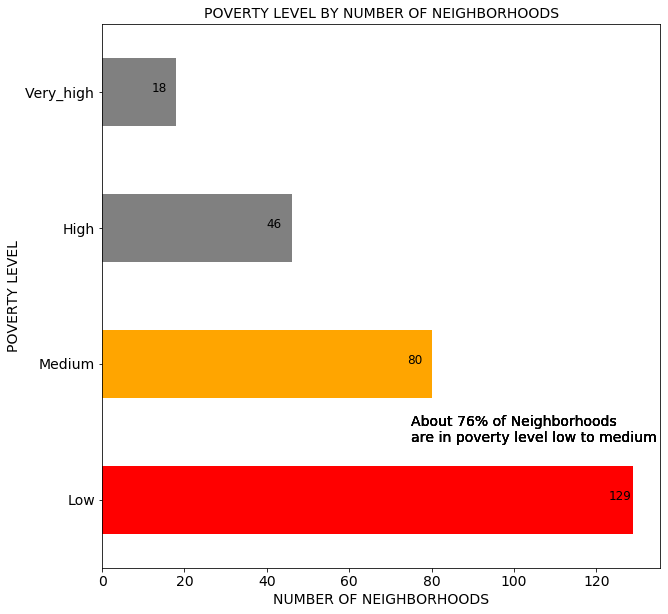

In [41]:
level.plot(kind='barh', figsize=(10, 10), color=[ 'red','orange','gray', 'gray',],fontsize=14)
plt.title('POVERTY LEVEL BY NUMBER OF NEIGHBORHOODS', size=14)
plt.xlabel('NUMBER OF NEIGHBORHOODS', size=14)
plt.ylabel('POVERTY LEVEL', size=14)
for index, value in enumerate(level): 
    label = value
    plt.annotate(label, xy=(value-6, index ), color='black', size=12)
    plt.annotate('About 76% of Neighborhoods \nare in poverty level low to medium ', # text to display
             xy=(75, 0.4),# start the text at at point (year 2008 , pop 30)
             size=14,
             rotation=0,                  # based on trial and error to match the arrow
             va='bottom',                    # want the text to be vertically 'bottom' aligned
             ha='left', # want the text to be horizontally 'left' algned.
            )
plt.show()

#### Data with new categorical poverty 

In [118]:
Med_ipm_category[['IPM','POVERTY_LEVEL','LEVEL']].head()

,IPM,POVERTY_LEVEL,LEVEL
0,23.347692,High,3
1,23.133333,High,3
2,29.224786,High,3
3,22.317722,High,3
4,22.534454,High,3


#### Making Pearson correlation between venues categories and Multidimensional Poverty Index (IPM) 
#### Positive pearson correlation by venue categories
#### Cable Car get the highest value with 0.33

In [43]:
corr = Med_ipm_category.corr()
c=corr[['IPM']].sort_values(by = 'IPM',ascending = False).style.background_gradient()
c

,IPM
IPM,1.000000
Cable Car,0.332600
Venue Longitude,0.306385
Neighborhood Longitude,0.306381
Print Shop,0.161168
Construction & Landscaping,0.138830
Caribbean Restaurant,0.129271
Other Great Outdoors,0.122789
Business Service,0.119900
Betting Shop,0.111954


#### Top 15 positive pearson correlation venues categories with IPM

In [44]:
# convert to list and drop 'IPM', 'Venue Longitude' and 'Neighborhood Longitude'
c1=c.index.values.tolist()
del(c1[0]);del(c1[1]);del(c1[1])
c1_cor=c1[0:15]
c1_cor

['Cable Car',
 'Print Shop',
 'Construction & Landscaping',
 'Caribbean Restaurant',
 'Other Great Outdoors',
 'Business Service',
 'Betting Shop',
 'Mountain',
 'Home Service',
 'Playground',
 'Science Museum',
 'Financial or Legal Service',
 'Jewelry Store',
 'Fabric Shop',
 'Farm']

#### Negative pearson correlation by venue categories
#### Supermarket get the highest negative value with 0.32

In [45]:
corr = Med_ipm_category.corr()
c2=corr[['IPM']].sort_values(by = 'IPM',ascending = True).style.background_gradient()
c2

,IPM
Supermarket,-0.321004
Pizza Place,-0.317404
Burger Joint,-0.316710
Venue Latitude,-0.306454
Neighborhood Latitude,-0.306428
Gym,-0.274519
Mexican Restaurant,-0.273248
Shopping Mall,-0.270657
Gym / Fitness Center,-0.264420
Bar,-0.253350


#### Top 15 negative pearson correlation venues categories with IPM

In [46]:
# convert to list
c_inv=c2.index.values.tolist()


In [47]:
# drop 'Venue Latitude' and 'Neighborhood Latitude'
del(c_inv[3]);del(c_inv[3])
c2_cor=c_inv[0:15]
c2_cor

['Supermarket',
 'Pizza Place',
 'Burger Joint',
 'Gym',
 'Mexican Restaurant',
 'Shopping Mall',
 'Gym / Fitness Center',
 'Bar',
 'Bakery',
 'Italian Restaurant',
 'Restaurant',
 'Steakhouse',
 'BBQ Joint',
 'Ice Cream Shop',
 'Hotel']

#### New list with all 30 positive and negative correlation, to seek an categorical IPM possible prediction

In [48]:
c1_cor.extend(c2_cor)
c1_cor

['Cable Car',
 'Print Shop',
 'Construction & Landscaping',
 'Caribbean Restaurant',
 'Other Great Outdoors',
 'Business Service',
 'Betting Shop',
 'Mountain',
 'Home Service',
 'Playground',
 'Science Museum',
 'Financial or Legal Service',
 'Jewelry Store',
 'Fabric Shop',
 'Farm',
 'Supermarket',
 'Pizza Place',
 'Burger Joint',
 'Gym',
 'Mexican Restaurant',
 'Shopping Mall',
 'Gym / Fitness Center',
 'Bar',
 'Bakery',
 'Italian Restaurant',
 'Restaurant',
 'Steakhouse',
 'BBQ Joint',
 'Ice Cream Shop',
 'Hotel']

#### Extend the previous list with ['IPM','POVERTY_LEVEL']

In [49]:
v=['IPM','POVERTY_LEVEL']
c1_cor.extend(v)
c1_cor

['Cable Car',
 'Print Shop',
 'Construction & Landscaping',
 'Caribbean Restaurant',
 'Other Great Outdoors',
 'Business Service',
 'Betting Shop',
 'Mountain',
 'Home Service',
 'Playground',
 'Science Museum',
 'Financial or Legal Service',
 'Jewelry Store',
 'Fabric Shop',
 'Farm',
 'Supermarket',
 'Pizza Place',
 'Burger Joint',
 'Gym',
 'Mexican Restaurant',
 'Shopping Mall',
 'Gym / Fitness Center',
 'Bar',
 'Bakery',
 'Italian Restaurant',
 'Restaurant',
 'Steakhouse',
 'BBQ Joint',
 'Ice Cream Shop',
 'Hotel',
 'IPM',
 'POVERTY_LEVEL']

#### Available data with 30 venues categories

In [50]:

MED_REG=Med_ipm_category[c1_cor]
MED_REG.head()

,Cable Car,Print Shop,Construction & Landscaping,Caribbean Restaurant,Other Great Outdoors,Business Service,Betting Shop,Mountain,Home Service,Playground,Science Museum,Financial or Legal Service,Jewelry Store,Fabric Shop,Farm,Supermarket,Pizza Place,Burger Joint,Gym,Mexican Restaurant,Shopping Mall,Gym / Fitness Center,Bar,Bakery,Italian Restaurant,Restaurant,Steakhouse,BBQ Joint,Ice Cream Shop,Hotel,IPM,POVERTY_LEVEL
0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,23.347692,High
1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,23.133333,High
2,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,29.224786,High
3,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,22.317722,High
4,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,22.534454,High


#### Maximum IPM average value is 58,65 for all 273 Neighborhoods

In [51]:
MED_REG['IPM'].describe()

count    273.000000
mean      13.081209
std       10.601138
min        0.000000
25%        4.795833
50%       10.419149
75%       19.542000
max       58.650000
Name: IPM, dtype: float64

##### Example group by Burger Joint and poverty level value counts
#### Low Poverty level corresponds with more Burger Joint places

In [52]:
MED_REG.groupby(['Burger Joint'])['POVERTY_LEVEL'].value_counts(normalize=True)

Burger Joint  POVERTY_LEVEL
0             Low              0.368687
              Medium           0.323232
              High             0.222222
              Very_high        0.085859
1             Low              0.666667
              Medium           0.291667
              High             0.020833
              Very_high        0.020833
2             Low              1.000000
3             Low              0.750000
              Medium           0.250000
4             High             0.500000
              Low              0.500000
5             Low              1.000000
6             Low              1.000000
7             Low              1.000000
Name: POVERTY_LEVEL, dtype: float64

### 3.2 PREDICTIVE MODELING
#### Several kind of algorithms were used in this study starting with K-Nearest Neighbors, Decision Tree, Support Vector Machine Evaluation and Logistic Regression.
#### Using  first 25 from 30 categorical data get the best results with X variable to modeling

In [53]:
X = MED_REG[c1_cor[:-7]]
MED_REG.head().values  #.astype(float)
X[0:5]

,Cable Car,Print Shop,Construction & Landscaping,Caribbean Restaurant,Other Great Outdoors,Business Service,Betting Shop,Mountain,Home Service,Playground,Science Museum,Financial or Legal Service,Jewelry Store,Fabric Shop,Farm,Supermarket,Pizza Place,Burger Joint,Gym,Mexican Restaurant,Shopping Mall,Gym / Fitness Center,Bar,Bakery,Italian Restaurant
0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0


#### Checking 'X' variable possible Null values

In [54]:
X.isnull().values.any()

False

#### Checking X variable shape is according to 273 Neighborhoods and 25 venues categories

In [55]:
X.shape

(273, 25)

#### 'Y' categorical poverty level variable to modeling

In [56]:
y = MED_REG['POVERTY_LEVEL'].values
y[0:10]

[High, High, High, High, High, Medium, Very_high, Very_high, High, Very_high]
Categories (4, object): [Low < Medium < High < Very_high]

#### Checking 'Y' variable null values

In [57]:
y.isnull()

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

#### Checking Y variable shape according with 273 Neighborhood

In [58]:
y.shape

(273,)


#### Normalize Data
#### Data Standardization give data zero mean and unit variance

In [59]:
from sklearn import preprocessing
X = preprocessing.StandardScaler().fit(X).transform(X.astype(float))
X[0:5]

array([[ 2.46401803, -0.12194215, -0.27350164,  6.164414  , -0.10540926,
        -0.10540926, -0.08590736, -0.13658959, -0.18463724, -0.10540926,
        -0.14990634, -0.08590736, -0.08590736, -0.06063391, -0.10540926,
        -0.47335705, -0.43548469, -0.45015905, -0.40172539, -0.34734659,
        -0.46989209, -0.43045803, -0.36988074, -0.33210177, -0.31591289],
       [-0.2928546 ,  8.20060973, -0.27350164,  6.164414  , -0.10540926,
        -0.10540926, -0.08590736, -0.13658959, -0.18463724, -0.10540926,
        -0.14990634, -0.08590736, -0.08590736, -0.06063391, -0.10540926,
        -0.47335705, -0.43548469, -0.45015905, -0.40172539, -0.34734659,
        -0.46989209, -0.43045803, -0.36988074, -0.33210177, -0.31591289],
       [ 5.22089067, -0.12194215, -0.27350164, -0.16222142, -0.10540926,
        -0.10540926, -0.08590736, -0.13658959, -0.18463724, -0.10540926,
        -0.14990634, -0.08590736, -0.08590736, -0.06063391, -0.10540926,
        -0.47335705, -0.43548469, -0.45015905, -0

### Classification

#### -K Nearest Neighbor(KNN)
#### -Decision Tree
#### -Support Vector Machine
#### -Logistic Regression

#### Training 80% and 20% test data

In [60]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.2, random_state=5)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)

Train set: (218, 25) (218,)
Test set: (55, 25) (55,)


### K Nearest Neighbor(KNN)
#### An algorithm for supervised learning. Where the data is 'trained' with data points corresponding to their classification. Once a point is to be predicted, it takes into account the 'K' nearest points to it to determine it´s classification

In [61]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

##### Searching the best K

In [62]:
Ks = 20
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))

for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.58181818, 0.61818182, 0.65454545, 0.70909091, 0.67272727,
       0.74545455, 0.65454545, 0.69090909, 0.67272727, 0.67272727,
       0.72727273, 0.72727273, 0.65454545, 0.69090909, 0.67272727,
       0.69090909, 0.69090909, 0.70909091, 0.61818182])

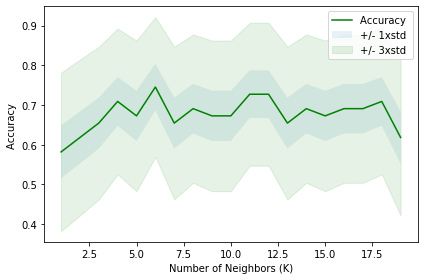

In [63]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.fill_between(range(1,Ks),mean_acc - 3 * std_acc,mean_acc + 3 * std_acc, alpha=0.10,color="green")
plt.legend(('Accuracy ', '+/- 1xstd','+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Neighbors (K)')
plt.tight_layout()
plt.show()

#### k=6 the best accuracy with 0.74 using 25 venues categories to predict categorical Poverty level

In [64]:
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1) 

The best accuracy was with 0.7454545454545455 with k= 6


In [65]:
k = 6
#Train Model and Predict  
neigh = KNeighborsClassifier(n_neighbors = k).fit(X_train,y_train)
neigh

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=6, p=2,
                     weights='uniform')

#### Comparing real values with predict values

In [66]:
yhat = neigh.predict(X_test)
print(yhat[0:5])
print(y_test[0:5])

['Low' 'Medium' 'Low' 'Medium' 'High']
[Low, Medium, Low, Medium, High]
Categories (4, object): [Low < Medium < High < Very_high]


In [67]:
print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh.predict(X_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhat))

Train set Accuracy:  0.6192660550458715
Test set Accuracy:  0.7454545454545455


### Decision Tree Algorithm
#### Decision Tree algorithm belongs to the family of supervised learning algorithms. Unlike other supervised learning algorithms, the decision tree algorithm can be used for solving regression and classification problems too.
#### The goal of using a Decision Tree is to create a training model that can use to predict the class or value of the target variable by learning simple decision rules inferred from prior data (training data).
#### In Decision Trees, for predicting a class label for a record we start from the root of the tree. We compare the values of the root attribute with the record’s attribute. On the basis of comparison, we follow the branch corresponding to that value and jump to the next node
#### Training 80% and 20% test data

In [68]:
from sklearn.tree import DecisionTreeClassifier

X_trainset, X_testset, y_trainset, y_testset = train_test_split(X, y, test_size=0.2, random_state=5)


In [69]:
#fit the data with the training feature matrix X and training response vector y
loanstatustree = DecisionTreeClassifier(criterion="entropy", max_depth =4)
loanstatustree
loanstatustree.fit(X_trainset,y_trainset)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=4, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

#### Comparing real values with predict values

In [70]:
#predictions on the testing dataset (from training) and store it into a variable called predTree.
predTree = loanstatustree.predict(X_testset)
print (predTree [0:10])
print (y_testset [0:10])

['Low' 'Medium' 'Low' 'Medium' 'High' 'Low' 'Low' 'Medium' 'Low' 'Medium']
[Low, Medium, Low, Medium, High, Low, Low, Medium, Medium, Low]
Categories (4, object): [Low < Medium < High < Very_high]


### SVM (Support Vector Machines)
#### SVM works by mapping data to a high-dimensional feature space so that data points can be categorized, even when the data are not otherwise linearly separable. A separator between the categories is found, then the data is transformed in such a way that the separator could be drawn as a hyperplane. Following this, characteristics of new data can be used to predict the group to which a new record should belong
#### Training 80% and 20% test data

In [71]:
X_trainsv, X_testsv, y_trainsv, y_testsv = train_test_split( X, y, test_size=0.2, random_state=5)

In [72]:
from sklearn import svm
clf = svm.SVC(kernel='rbf')
clf.fit(X_trainsv, y_trainsv)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

#### Comparing real values with predict values

In [73]:
#predictions on the testing dataset (from training)
yhatsv = clf.predict(X_testsv)
print (yhatsv [0:5])
print (y_testsv [0:5])

['Low' 'Low' 'Low' 'Medium' 'High']
[Low, Medium, Low, Medium, High]
Categories (4, object): [Low < Medium < High < Very_high]


### Logistic Regression

#### Logistic Regression is a variation of Linear Regression, useful when the observed dependent variable y, is categorical. It produces a formula that predicts the probability of the class label as a function of the independent variables
#### Training 80% and 20% test data

In [74]:
X_trainlg, X_testlg, y_trainlg, y_testlg = train_test_split( X, y, test_size=0.2, random_state=5)
from sklearn.linear_model import LogisticRegression

LR = LogisticRegression(C=0.01, solver='liblinear').fit(X_trainlg,y_trainlg)
LR

LogisticRegression(C=0.01, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='liblinear', tol=0.0001, verbose=0,
                   warm_start=False)

#### Comparing real values with predict values

In [75]:
#predictions on the testing dataset (from training)
yhatlg = LR.predict(X_testlg)

print (yhatlg [0:5])
print (y_testlg [0:5])

['Low' 'Very_high' 'Low' 'Medium' 'High']
[Low, Medium, Low, Medium, High]
Categories (4, object): [Low < Medium < High < Very_high]


#### Check Y test variable shape to evaluation

In [76]:
y_test.shape

(55,)

### 3. RESULTS
#### After use 25 from 30 categorical data with the best results and several kind of algorithms such as K-Nearest Neighbors, Decision Tree, Support Vector Machine Evaluation and Logistic Regression, we check accuracy for each model evaluation, using Jaccard and F1 scores.

In [77]:
from sklearn.metrics import jaccard_score
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss

In [78]:
#K Nearest Neighbor(KNN) Evaluation

print('Jaccard KNN :',jaccard_score(y_test, yhat[0:55],average = 'weighted'))
print('F1 score KNN :',f1_score(y_test, yhat[0:55], average = 'weighted'))

Jaccard KNN : 0.6073376623376623
F1 score KNN : 0.7367539564260875


In [79]:
#Decision Tree Evaluation

print('Jaccard tree :',jaccard_score(y_testset, predTree[0:55],pos_label= None,average = 'weighted'))
print('F1 score tree :',f1_score(y_testset, predTree[0:55], average='weighted'))

Jaccard tree : 0.34609047550224015
F1 score tree : 0.5024242424242424


In [80]:
#Support Vector Machine Evaluation
print('Jaccard svm :',jaccard_score(y_testsv, yhatsv[0:55],pos_label= None,average = 'weighted'))
print('F1 score svm :',f1_score(y_testsv, yhatsv[0:55], average='weighted'))

Jaccard svm : 0.42029420747225893
F1 score svm : 0.5420543093270367


In [81]:
#Logistic Regression Evaluation

print('Jaccard lg :',jaccard_score(y_testlg, yhatlg[0:55],pos_label= None,average = 'weighted'))
print('F1 score lg :',f1_score(y_testlg, yhatlg[0:55], average='weighted'))


Jaccard lg : 0.495667263770712
F1 score lg : 0.6476795931341386


#### Final table with Jaccard and F1 score for each algorithm
#### The best accuracy was about 73% with K Nearest Neighbor, follow by Logistic Regression with 64% F1 score

In [82]:
Accuracy_table = pd.DataFrame({'Algorithm': ['KNN','Decision Tree', 'SVM','Logistic_Regression'],
                               'Jaccard': [jaccard_score(y_test, yhat[0:55],average = 'weighted'),
                                           jaccard_score(y_testset, predTree[0:55],pos_label= None,average = 'weighted'),
                                           jaccard_score(y_testsv, yhatsv[0:55],pos_label= None,average = 'weighted'),
                                          jaccard_score(y_testlg, yhatlg[0:55],pos_label= None,average = 'weighted')],
                              'F1_score':[f1_score(y_test, yhat[0:55], average = 'weighted'),
                                             f1_score(y_testsv, yhatsv[0:55], average='weighted'),
                                            f1_score(y_testset, predTree[0:55], average='weighted'),
                                            f1_score(y_testlg, yhatlg[0:55], average='weighted')]},
                            
                              columns=['Algorithm', 'Jaccard','F1_score'])
Accuracy_table

,Algorithm,Jaccard,F1_score
0,KNN,0.607338,0.736754
1,Decision Tree,0.346090,0.542054
2,SVM,0.420294,0.502424
3,Logistic_Regression,0.495667,0.647680


#### Final 25 venues categories used to predict with 73% F1 score accuracy.

In [83]:
venues_final_categories=c1_cor[:-7]
venues_final_categories

['Cable Car',
 'Print Shop',
 'Construction & Landscaping',
 'Caribbean Restaurant',
 'Other Great Outdoors',
 'Business Service',
 'Betting Shop',
 'Mountain',
 'Home Service',
 'Playground',
 'Science Museum',
 'Financial or Legal Service',
 'Jewelry Store',
 'Fabric Shop',
 'Farm',
 'Supermarket',
 'Pizza Place',
 'Burger Joint',
 'Gym',
 'Mexican Restaurant',
 'Shopping Mall',
 'Gym / Fitness Center',
 'Bar',
 'Bakery',
 'Italian Restaurant']

#### Total 1073 venues with 25 final categories

In [85]:
venues_ipm = Medellin_venues[Medellin_venues['Venue Category'].isin(venues_final_categories)]
venues_ipm.head()

,CODE,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
1,101,6.298,-75.544,Mi Cebi & Chela,6.293481,-75.541798,Caribbean Restaurant
2,101,6.298,-75.544,Metrocable Linea K - Estación Popular,6.295100,-75.548188,Cable Car
4,102,6.298,-75.539,Mi Cebi & Chela,6.293481,-75.541798,Caribbean Restaurant
5,102,6.298,-75.539,Litografia RM,6.293831,-75.542321,Print Shop
7,103,6.299,-75.548,Metrocable Linea K - Estación Popular,6.295100,-75.548188,Cable Car


In [86]:
venues_ipm.shape

(1073, 7)

### 4.1 Final map
#### Data tables
#### Creating Categorical poverty level for each neighborhood

In [88]:
cut_labels_4 = ['Low','Medium', 'High', 'Very_high']
labels=[1,2,3,4]
cut_bins = [0, 10,20,30, 60]
N_MED_IPM['POVERTY_LEVEL'] = pd.cut(N_MED_IPM['IPM'], bins=cut_bins, labels=cut_labels_4, right=False)
N_MED_IPM['LEVEL'] = pd.cut(N_MED_IPM['IPM'], bins=cut_bins, labels=labels,right=False)
N_MED_IPM.head()

,CODE,IPM,Neighborhoods,Boroughs,Lat,Long,POVERTY_LEVEL,LEVEL
0,101,23.347692,Santo Domingo Savio No.1,Popular,6.298,-75.544,High,3
1,102,23.133333,Santo Domingo Savio No.2,Popular,6.298,-75.539,High,3
2,103,29.224786,Popular,Popular,6.299,-75.548,High,3
3,104,22.317722,Granizal,Popular,6.292,-75.546,High,3
4,105,22.534454,Moscú No.2,Popular,6.290,-75.550,High,3


#### Creating new variables and review data to comparing similar type data columns with geojson Neighborhoods

In [89]:
codes_med=N_MED_IPM.copy()
 

#### Geojson data has a column called 'CODIGO' with one zero before numbers when lenght =3, for example our column called ‘CODE’ for one Neighborhood is 101, but in Geojson it's number is 0101. Then is necessary a new column with codes with equal codes in Geojson and draw IPM value for each neighborhood.

In [120]:
# open the json file - json.load() methods returns a python dictionary
with open(Neighborhood_limits) as codigos_file:
    codigos_json = json.load(codigos_file)
    
# we loop through the dictionary to obtain the name of the communities in the json file
denominations_json = []
for index in range(len(codigos_json['features'])):
    denominations_json.append(codigos_json['features'][index]['properties']['CODIGO'])
    
denominations_json[0:5]

['1422', '0810', '0719', '0102', '0302']

#### Changes variables type to search data in geojson

In [92]:

 codes_med['LEVEL'] = codes_med['LEVEL'].replace(',','.').astype(float)

In [93]:
codes_med['CODE'] = codes_med['CODE'].replace().astype(str)

In [94]:
codes_med.dtypes

CODE               object
IPM               float64
Neighborhoods      object
Boroughs           object
Lat               float64
Long              float64
POVERTY_LEVEL    category
LEVEL             float64
dtype: object

In [95]:
codes_med['CODIGO']=""
for i,cod in codes_med['CODE'].iteritems():
    if len(cod)==3 and cod[0]!='A':
        codes_med['CODIGO'][i]=cod.zfill(4)
    else:
        codes_med['CODIGO'][i]=cod
            

/home/daren/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/home/daren/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


####  We get the same columns name 'CODIGO' and the same code lenght than Geojson

In [116]:
codes_med.head()

,CODE,IPM,Neighborhoods,Boroughs,Lat,Long,POVERTY_LEVEL,LEVEL,CODIGO
0,101,23.347692,Santo Domingo Savio No.1,Popular,6.298,-75.544,High,3.0,0101
1,102,23.133333,Santo Domingo Savio No.2,Popular,6.298,-75.539,High,3.0,0102
2,103,29.224786,Popular,Popular,6.299,-75.548,High,3.0,0103
3,104,22.317722,Granizal,Popular,6.292,-75.546,High,3.0,0104
4,105,22.534454,Moscú No.2,Popular,6.290,-75.550,High,3.0,0105


#### Geojson with Urban Neighborhood

In [98]:
Neighborhood_urban = r'/home/daren/data science/medellin/Urban_Med.geojson'

#### Final Map with venues using to training and test model (blue) and categorical Multidimensional Poverty Index: Low (0-10) (Green), Medium (10-20) (Yellow), High (20-30) (Purple) and Very high >30(Red) in Medellin city, Colombia.

#### Showing 55% of all venues with 25 categories in map

In [117]:
vt=venues_ipm.sample(frac=0.55,random_state=3)



### Final Map
#### Map with 55% of venues using to training and test model (blue) and categorical Multidimensional Poverty Index: Low (0-10) (Green), Medium (10-20) (Yellow), High (20-30) (Purple) and Very high >30(Red) in Medellin city, Colombia.

In [111]:
from folium import plugins
from folium.folium import Map
from folium.map import Tooltip
# create map of Medellin using latitude and longitude values
map_medellin_ipm = folium.Map(location=[latitudet, longitudet], zoom_start=10,control_scale = True)
# generate choropleth map 
folium.Choropleth(
           geo_data=Neighborhood_urban,
           data=codes_med,
           columns=['CODIGO','IPM'], 
           threshold_scale=[0,10,20,30,60],
           key_on='feature.properties.CODIGO', 
           fill_color='Set3',
           fill_opacity=0.6, 
           line_opacity=1,
           legend_name='The Multidimensional Poverty Index average by Neighborhood',
           highlight=True,
           smooth_factor=0
).add_to(map_medellin_ipm)
style_function = lambda x: {
    'fillColor': '#00FFFFFF',
    'color': 'black',
    'weight': 0.2,
    'fillOpacity': 0   
}

folium.GeoJson(
    Neighborhood_urban,
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=['NOMBRE','NOMBRE_COM'],
        aliases=['Neighborhood: ', 'Borough: '],
        localize=True
    )
).add_to(map_medellin_ipm) 

# add markers to map
for Latitude, Longitude, Venue in zip(vt['Venue Latitude'], vt['Venue Longitude'], vt['Venue']):
    label = Venue
    lab=str(label.encode('raw_unicode_escape'))[2:-1]
    lab= html.escape(lab)
    folium.CircleMarker(
        [Latitude, Longitude],
        popup="Venue: "+lab,
        radius= 3,
        color='blue',
        fill=True,
        fill_color='white',
        fill_opacity=0.8).add_to(map_medellin_ipm) 
plugins.Fullscreen(position='topright').add_to(map_medellin_ipm)
draw = plugins.Draw(export=True)
minimap = plugins.MiniMap( toggle_display=True, position='topleft',zoom_level_offset=-8)
map_medellin_ipm.add_child(minimap)
    
map_medellin_ipm

##### We can see that the very high values are in North and Northeast (Red colors) and low values from South to North, following almost a line (Green color), medium and high values around it with higher values to the west (Purple color). Center to South east corresponds to the best zone according to more values low and medium.

### 4. DISCUSSIONS
#### Clearly the worst zones correspond to mountain zones and boroughs around the urban city. These neighborhoods need especial attention. Prediction only with venues and categories is a good way to see the categorical poverty and local situation as an approximation, but not like a unique reference, because the lack of information, decreases better results and accuracy.
#### However, K-Nearest Neighbors model is a useful tool and could be the first step to have an idea about Multidimensional Poverty Index and using this information to possible new neighborhood constructions, marketing, territorial ordainment and set new strategies to reduce poverty to lowest values.
#### According to previous information recommendations are:
    • Extract all possible data from venues and improve model and accuracy to have better results.
    • Avoid lack of information like in the south west from the map with only one venue in five neighborhoods.
    • Many places are not clearly identified they are the black zones from the map, like parks and green zones and other places.
    • Places without houses or buildings does not have  Multidimensional Poverty Index, and could create biases in a few neighborhoods
    • Mountain zones and big neighborhoods have a problem with coordinates, because we only use one point inside the neighborhood and with 600 meters of radio is not the best way, maybe those big neighborhoods needs two or more points 
    • Choose categories is not an easy task, here is important evaluate categories and which ones are the better with entire data, according to correlation here was used 25 categories but with full data this could be changed.


### 5. CONCLUSIONS

#### Using a free foursquare account and coordinates from each neighborhood with radius of 600 meters, it could extract 4058 venues and 236 unique categories from Medellin city, Colombia. With a final data from 25 categories and  1073 venues use to training and test to 273 urban neighborhoods.
#### Several kind of algorithms were used in this study starting with K-Nearest Neighbors, Decision Tree, Support Vector Machine Evaluation and Logistic Regression. The best result was K-Nearest Neighbors with 73% of F1 score accuracy, using K= 6, follow by Logistic Regression with 64%.
#### Multidimensional Poverty Index (IPM) has a classification from Low to very high, according to the all 277 neighborhoods, Low is the most frequent 129, Medium 80, High 46, and Very high 18.
#### Very high values are in the North and Northeast and low values from South to North, medium and high values around it, with higher values to the west. Center to South east zone corresponds to the best zone according to more values low and medium in Medellin city.

#### Prediction to Multidimensional Poverty Index (IPM) only with venues and categories is a good way to see the categorical poverty and local situation as an approximation, but not like a unique reference, because the lack of information, decreases better results and accuracy. However, K-Nearest Neighbors model is a useful tool and could be the first step to have an idea about Multidimensional Poverty Index and use this information to possible new neighborhood constructions, marketing, territorial ordainment and set new strategies to reduce poverty to lowest values.

#### To next researches and improve this study is necessary to extract all possible data from venues in the entire city with a premium account at foursquare and building new models having accuracy above 73% and taking in count categories with higher weight in the full data.

### 5. REFERENCES 
#### 1-IBM Developer skill Network. Data Science labs.
#### 2-https://www.kdnuggets.com
#### Free software:
#### 3-QGIS: https://www.qgis.org/es/site/

#### Free data:
#### Multidimensional Poverty Index  Medellin, Colombia: https://geoportal.dane.gov.co/visipm/
#### Shapes Medellin Neighborhoods: https://geomedellin-m-medellin.opendata.arcgis.com/datasets/barrio-vereda
#### Venues data download site: www.foursquare.com